# Week 6 Paractcical

1 Zachary’s Karate Club
In this practical, we will use the networkx library to perform community detection on a network. We will use the Zachary’s Karate Club network, which is a social network of a university karate club as an example.

Zachary’s Karate Club network is a well-known social network data set originating from the work of Wayne W. Zachary, who conducted a study on the social interactions within a karate club at an American university between 1970 and 1972. The purpose of Zachary’s study was to observe and document the social relationships among the club’s members and understand how conflicts and group dynamics can influence the network’s structure.

A significant aspect of Zachary’s study was the conflict that arose within the club, leading to its eventual split into two factions. This split was due to a disagreement between the club’s instructor and the club’s president over the price of karate lessons. The instructor favoured a higher fee, while the president wanted to keep the fees lower. This disagreement escalated, causing the club members to align themselves with either the instructor or the president.

The network data represents the social relationships between the club members during this period of conflict. The data set consists of 34 nodes (representing the club members) and 78 edges (representing the friendships between members). Each edge in the network data has a weight, reflecting the number of common activities the club members took part of.

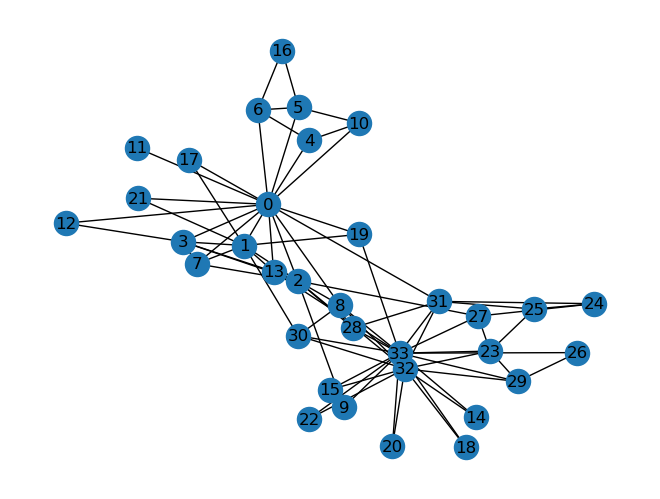

In [1]:
import networkx as nx
import matplotlib.pyplot as plt

# Load the Zachary's Karate Club network
G = nx.karate_club_graph()

# Visualize the network
pos = nx.spring_layout(G, seed=42)
nx.draw(G, pos, with_labels=True)
plt.show()

The network has a node attribute club that indicates the faction of each member, as well as an edge attribute weight that indicates the strength of the relationship between two members.


In [2]:
# Print the node attributes
print("Node attributes:")
print(G.nodes(data=True))

# Print the edge attributes
print("\nEdge attributes:")
print(G.edges(data=True))

Node attributes:
[(0, {'club': 'Mr. Hi'}), (1, {'club': 'Mr. Hi'}), (2, {'club': 'Mr. Hi'}), (3, {'club': 'Mr. Hi'}), (4, {'club': 'Mr. Hi'}), (5, {'club': 'Mr. Hi'}), (6, {'club': 'Mr. Hi'}), (7, {'club': 'Mr. Hi'}), (8, {'club': 'Mr. Hi'}), (9, {'club': 'Officer'}), (10, {'club': 'Mr. Hi'}), (11, {'club': 'Mr. Hi'}), (12, {'club': 'Mr. Hi'}), (13, {'club': 'Mr. Hi'}), (14, {'club': 'Officer'}), (15, {'club': 'Officer'}), (16, {'club': 'Mr. Hi'}), (17, {'club': 'Mr. Hi'}), (18, {'club': 'Officer'}), (19, {'club': 'Mr. Hi'}), (20, {'club': 'Officer'}), (21, {'club': 'Mr. Hi'}), (22, {'club': 'Officer'}), (23, {'club': 'Officer'}), (24, {'club': 'Officer'}), (25, {'club': 'Officer'}), (26, {'club': 'Officer'}), (27, {'club': 'Officer'}), (28, {'club': 'Officer'}), (29, {'club': 'Officer'}), (30, {'club': 'Officer'}), (31, {'club': 'Officer'}), (32, {'club': 'Officer'}), (33, {'club': 'Officer'})]

Edge attributes:
[(0, 1, {'weight': 4}), (0, 2, {'weight': 5}), (0, 3, {'weight': 3}), (0,

Let’s visualise the factions of the club members using different colors.

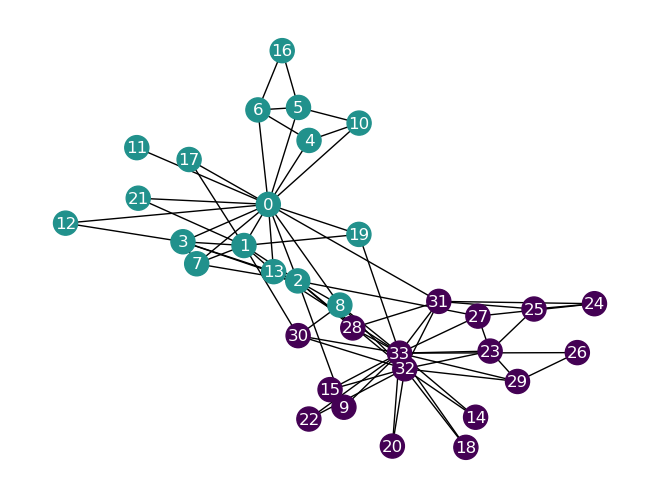

In [3]:
# Extract the attribute 'club' from the nodes
clubs = [club for _, club in G.nodes(data='club')]

# Enumerate the values
unique_clubs = list(set(clubs))
club_colors = {club: i for i, club in enumerate(unique_clubs)}

# Create a color map using a rainbow palette
color_map = [plt.cm.viridis(club_colors[club] / len(unique_clubs)) for club in clubs]

# Visualize the network with node colors
nx.draw(G, pos, node_color=color_map, with_labels=True, font_color='white')
plt.show()

# 2 More on Modularity
We can use built-in methods to calculate the modularity of the network.

In [4]:
# Extract communities from the node attribute 'club'
clubs = {club for _, club in G.nodes(data="club")}
communities = {club: [] for club in clubs}
for node, club in G.nodes(data="club"):
    communities[club].append(node)

print("Communities:", communities)

# Calculate the modularity of the network
modularity = nx.algorithms.community.modularity(G, communities.values())
print("Modularity:", modularity)

Communities: {'Officer': [9, 14, 15, 18, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], 'Mr. Hi': [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 16, 17, 19, 21]}
Modularity: 0.39143756676224206


# 2.1 Community Detection using Louvain Method
Let’s use the Louvain method to detect communities in the network. The Louvain method is a popular algorithm for community detection in networks. It is based on the concept of modularity optimization, where the algorithm aims to maximize the modularity of the network by iteratively moving nodes between communities.

# Use the Louvain method to detect communities in the network
partition = nx.community.louvain_communities(G, seed=42)

# Visualize the communities
colors = [plt.cm.viridis(i / len(partition)) for i in range(len(partition))]
pos = nx.spring_layout(G, seed=42)
for i, community in enumerate(partition):
  nx.draw_networkx_nodes(G, pos, nodelist=list(community), node_color=colors[i], label=f'Community {i+1}', node_size=100)
nx.draw_networkx_edges(G, pos)
plt.legend()
plt.show()

# Calculate the modularity of the partition
modularity = nx.algorithms.community.modularity(G, partition)
print("Modularity:", modularity)

# Use the Louvain method to detect communities in the network
partition = nx.community.louvain_communities(G, seed=42)

# Visualize the communities
colors = [plt.cm.viridis(i / len(partition)) for i in range(len(partition))]
pos = nx.spring_layout(G, seed=42)
for i, community in enumerate(partition):
  nx.draw_networkx_nodes(G, pos, nodelist=list(community), node_color=colors[i], label=f'Community {i+1}', node_size=100)
nx.draw_networkx_edges(G, pos)
plt.legend()
plt.show()

# Calculate the modularity of the partition
modularity = nx.algorithms.community.modularity(G, partition)
print("Modularity:", modularity)

/home/zhiming/miniconda3/envs/ST5225/lib/python3.12/site-packages/networkx/drawing/nx_pylab.py:437: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


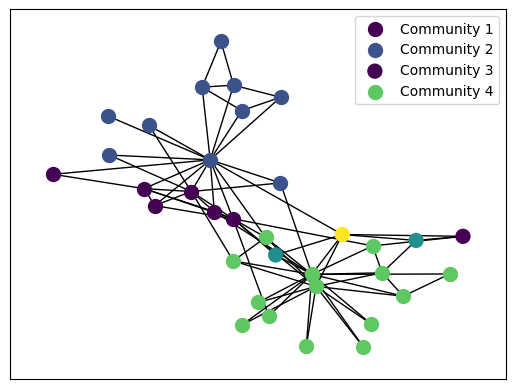

Modularity: 0.4266224396094526


In [5]:
# Use the Louvain method to detect communities in the network
partition = nx.community.louvain_communities(G, seed=42)

# Visualize the communities
colors = [plt.cm.viridis(i / len(partition)) for i in range(len(partition))]
pos = nx.spring_layout(G, seed=42)
for i, community in enumerate(partition):
  nx.draw_networkx_nodes(G, pos, nodelist=list(community), node_color=colors[i], label=f'Community {i+1}', node_size=100)
nx.draw_networkx_edges(G, pos)
plt.legend()
plt.show()

# Calculate the modularity of the partition
modularity = nx.algorithms.community.modularity(G, partition)
print("Modularity:", modularity)

Leiden Algorithm, gamma is high ==> gamma is a treshold 

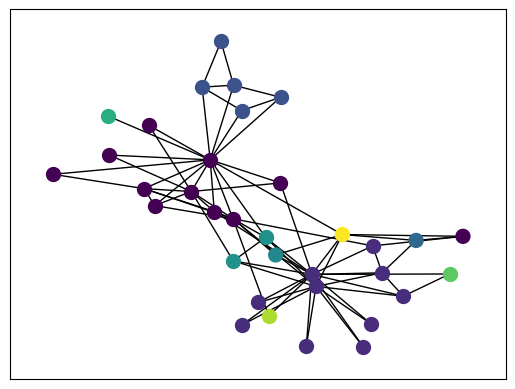

In [6]:
import igraph as ig
import leidenalg as la

# Create a simple graph
g = ig.Graph.Famous("Zachary")  # Zachary's Karate Club graph

# Detect communities using the Leiden algorithm
partition = la.find_partition(g, la.CPMVertexPartition, resolution_parameter=0.2)

# Visualize the communities
colors = [plt.cm.viridis(i / len(partition)) for i in range(len(partition))]
pos = nx.spring_layout(G, seed=42)
for i, community in enumerate(partition):
  nx.draw_networkx_nodes(G, pos, nodelist=list(community), node_color=colors[i], node_size=100)
nx.draw_networkx_edges(G, pos)
plt.show()

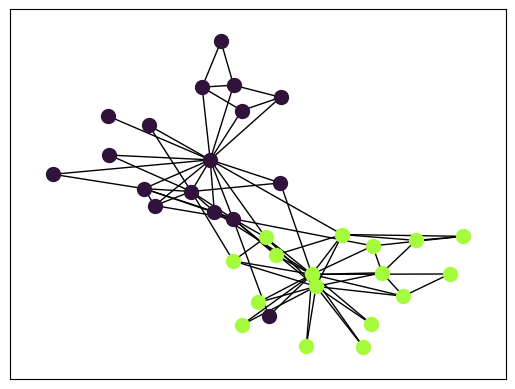

In [7]:
import igraph as ig
import leidenalg as la

# Create a simple graph
g = ig.Graph.Famous("Zachary")  # Zachary's Karate Club graph

# Detect communities using the Leiden algorithm
partition = la.find_partition(g, la.CPMVertexPartition, resolution_parameter=0.05)

# Visualize the communities
colors = [plt.cm.turbo(i / len(partition)) for i in range(len(partition))]
pos = nx.spring_layout(G, seed=42)
for i, community in enumerate(partition):
  nx.draw_networkx_nodes(G, pos, nodelist=list(community), node_color=colors[i], node_size=100)
nx.draw_networkx_edges(G, pos)
plt.show()

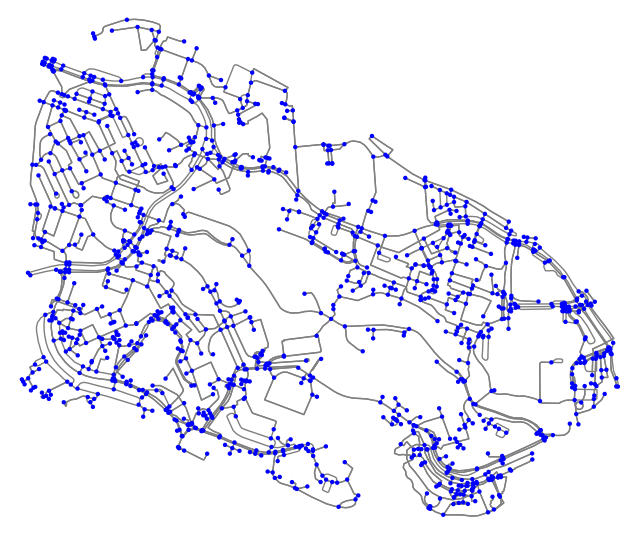

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [23]:
import osmnx as ox # pip install folium matplotlib mapclassify

G = ox.graph_from_place('National University of Singapore', network_type='all')

ox.plot_graph(G, node_size=10, node_color='blue', edge_color='gray', bgcolor='white')

# # If you want to have an interactive map, you can use the following code
# mp = ox.graph_to_gdfs(G, nodes=False).explore()
# mp

In [24]:
import matplotlib.pyplot as plt
import folium
import numpy as np

def plotClusters(G, partition, mp=None):
  """
  Parameters:
  - G: NetworkX graph object.
    The graph object containing the nodes and edges.
  - partition: dict or list
    If a list:
      - It can be of the same length as the number of nodes in the graph,
        representing the cluster assignment for each node.
      - It can be a list of communities, where each community is a list of nodes.
    If a dict, it should map nodes to cluster IDs.
  - mp: folium.Map (optional)
    A folium map object to add the clusters to. If None, a new map centered on the 
    National University of Singapore will be created.
  """
  # This part of the code ensures that the partision is a dictornary of communities, 
  # enumerated starting from 0
  if type(partition) == np.ndarray:
    partition = list(partition)
  if type(partition) == list:
    if len(partition) == len(G.nodes()):
      nodes = list(G.nodes())
      new_partition = dict()
      for i in range(len(partition)):
        if partition[i] not in new_partition.keys():
          new_partition[partition[i]] = [nodes[i]]
        else:
          new_partition[partition[i]].append(nodes[i])
      partition = dict(enumerate(new_partition.values()))
    else:
      partition = dict(enumerate(partition))
  elif type(partition) == 'dict':
      partition = dict(enumerate(partition.values()))
  
  
  # This generates the map
  df = ox.geocoder.geocode_to_gdf('National University of Singapore')
  lat = df['lat']
  lon = df['lon']
  if mp is None:
    mp = folium.Map((lat, lon), zoom_start = 16)

  colors_palette = ['red', 'blue', 'green', 'purple', 'orange', 'pink', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']
  colors = [colors_palette[i % len(colors_palette)] for i in range(len(partition))]

  # Go through each community and add the nodes to the map
  for col, community in partition.items():
    for node in community:
      folium.CircleMarker(
          location=[G.nodes()[node]['y'], G.nodes()[node]['x']],
          radius=3,
          color=colors[col],
          stroke=False,
          fill=True,
          fill_opacity=1,
          opacity=1,
      ).add_to(mp)
  return mp

In [25]:
G_simple = nx.Graph()
G_simple.add_nodes_from(G.nodes(data=True))
nodes = list(G.nodes())
for i in range(len(G.nodes)):
  for j in range(i + 1, len(G.nodes)):
      u, v = nodes[i], nodes[j]
      if G.has_edge(u, v):
          min_length = min([d['length'] for i, j, d in G.edges(data=True) if (i, j) in [(u, v), (v, u)]])
          G_simple.add_edge(u, v, length=min_length)
# Let's extract the largest connected component
G_simple = G_simple.subgraph(max(nx.connected_components(G_simple), key=len)).copy()

In [26]:
partition = nx.community.louvain_communities(G_simple, seed=42)
plotClusters(G_simple, partition, ox.graph_to_gdfs(G, nodes=False).explore())
print(f"Number of communities: {len(partition)}")
plotClusters(G_simple, partition, ox.graph_to_gdfs(G, nodes=False).explore())

Number of communities: 28


In [27]:
partition = nx.community.louvain_communities(G_simple, weight="length", seed=42, resolution=0.01)
print(f"Number of communities: {len(partition)}")
plotClusters(G_simple, partition, ox.graph_to_gdfs(G, nodes=False).explore())

Number of communities: 4


In [43]:
import networkx as nx
from sklearn.cluster import KMeans
L = nx.laplacian_matrix(G_simple, weight="length").astype(float).toarray()
eigvals, eigvecs = np.linalg.eigh(L)
eigvecs = eigvecs[:, 1:6]
kmeans = KMeans(n_clusters=5)
labels = kmeans.fit_predict(eigvecs)
plotClusters(G_simple, labels, ox.graph_to_gdfs(G, nodes=False).explore())

In [41]:
# Eigenvector 0 is a constant vector, so we will use the second eigenvector onwards
eigvecs = eigvecs[:, 0:5]

In [42]:
print(eigvecs)

[[-0.03463679  0.01429492 -0.02779354  0.03749828 -0.01052893]
 [-0.03085475 -0.02199626  0.03000951 -0.02190073  0.01188298]
 [-0.03275445  0.01160522 -0.02098309  0.03218361 -0.0052031 ]
 ...
 [-0.02693245 -0.02483413  0.03274951 -0.02742073 -0.00598184]
 [-0.02820253  0.02093634 -0.03736989  0.02306006 -0.01815648]
 [-0.03180786  0.01596307 -0.02923568  0.03204025 -0.01249141]]


In [44]:
kmeans = KMeans(n_clusters=4)
labels = kmeans.fit_predict(eigvecs)
plotClusters(G_simple, labels, ox.graph_to_gdfs(G, nodes=False).explore())

# From scratch with normalised Laplacian from distance matrix
Let’s see what happens when we use the normalised Laplacian matrix.

In [45]:
import networkx as nx
from sklearn.cluster import KMeans
L = nx.normalized_laplacian_matrix(G_simple, weight='length').astype(float).toarray()
eigvals, eigvecs = np.linalg.eigh(L)
eigvecs = eigvecs[:, 1:6]
kmeans = KMeans(n_clusters=5)
labels = kmeans.fit_predict(eigvecs)
plotClusters(G_simple, labels, ox.graph_to_gdfs(G, nodes=False).explore())

Algo is ignoring distance information as it is being normalised to remove the edge len information...

In [46]:
import networkx as nx
from sklearn.cluster import KMeans
L = nx.normalized_laplacian_matrix(G_simple).astype(float).toarray()
eigvals, eigvecs = np.linalg.eigh(L)
print(eigvecs)
eigvecs = eigvecs[:, 1:6]
kmeans = KMeans(n_clusters=5)
labels = kmeans.fit_predict(eigvecs)
plotClusters(G_simple, labels, ox.graph_to_gdfs(G, nodes=False).explore())

[[ 3.19655809e-02 -4.29453087e-02  7.53012412e-03 ...  1.70488980e-06
  -6.14714297e-12  5.41123113e-11]
 [ 1.84553368e-02 -1.05542280e-02 -2.66634722e-02 ... -1.15927029e-02
   2.23223766e-07 -6.89050488e-07]
 [ 3.19655809e-02 -3.82026950e-02  1.57184487e-03 ... -6.47871658e-08
  -2.10151103e-10  8.59065309e-11]
 ...
 [ 2.60997875e-02 -8.81351525e-03 -3.73760745e-02 ... -7.89908328e-03
   1.52168409e-07 -4.66152654e-07]
 [ 3.69106735e-02 -4.79815831e-02  1.70427108e-02 ...  7.61166141e-09
  -6.48638597e-11  2.22090905e-11]
 [ 3.19655809e-02 -4.19780397e-02  1.10526157e-02 ...  2.46361575e-08
  -4.40770291e-11  1.82210560e-11]]
